In [2]:
import config
import torch
import torch.optim as optim

from model import YOLOv3
from tqdm import tqdm
from utils import (
    mean_average_precision,
    cells_to_bboxes,
    get_evaluation_bboxes,
    save_checkpoint,
    load_checkpoint,
    check_class_accuracy,
    get_loaders,
    plot_couple_examples
)
from loss import YoloLoss
import warnings
warnings.filterwarnings("ignore")

/opt/conda/lib/python3.10/site-packages/scipy/__init__.py:146: UserWarning: A NumPy version >=1.16.5 and <1.23.0 is required for this version of SciPy (detected version 1.23.5
  warnings.warn(f"A NumPy version >={np_minversion} and <{np_maxversion}"


In [1]:
import shutil
df='qwerfdsa'
shutil.copyfile(f'../input/{df}/config.py', '../working/config.py')
shutil.copyfile(f'../input/{df}/dataset.py', '../working/dataset.py')
shutil.copyfile(f'../input/{df}/loss.py', '../working/loss.py')
shutil.copyfile(f'../input/{df}/model.py', '../working/model.py')
shutil.copyfile(f'../input/{df}/train.py', '../working/train.py')
shutil.copyfile(f'../input/{df}/utils.py', '../working/utils.py')

'../working/utils.py'

In [3]:
def train_fn(train_loader, model, optimizer, loss_fn, scaler, scaled_anchors, scheduler):
    loop = tqdm(train_loader, leave=True)
    losses = []
    for batch_idx, (x, y) in enumerate(loop):
        x = x.to(config.DEVICE)
        y0, y1, y2 = (
            y[0].to(config.DEVICE),
            y[1].to(config.DEVICE),
            y[2].to(config.DEVICE),
        )

        with torch.cuda.amp.autocast():
            out = model(x)
            loss = (
                loss_fn(out[0], y0, scaled_anchors[0])
                + loss_fn(out[1], y1, scaled_anchors[1])
                + loss_fn(out[2], y2, scaled_anchors[2])
            )

        losses.append(loss.item())
        optimizer.zero_grad()
        scaler.scale(loss).backward()
        scaler.step(optimizer)
        scaler.update()
        scheduler.step()

        # update progress bar
        mean_loss = sum(losses) / len(losses)
        loop.set_postfix(loss=mean_loss)

In [4]:
model = YOLOv3(num_classes=config.NUM_CLASSES).to(config.DEVICE)
model = torch.nn.DataParallel(model, device_ids=[0, 1])
optimizer = optim.Adam(
    model.parameters(), lr=config.LEARNING_RATE, weight_decay=config.WEIGHT_DECAY
)
loss_fn = YoloLoss()
scaler = torch.cuda.amp.GradScaler()

train_loader, test_loader, train_eval_loader = get_loaders(
    train_csv_path=config.DATASET + "/train.csv", test_csv_path=config.DATASET + "/test.csv"
)

if config.LOAD_MODEL:
    load_checkpoint(
        config.CHECKPOINT_FILE, model, optimizer, config.LEARNING_RATE
    )


  0%|          | 0/200 [00:00<?, ?it/s]

Learning rate search finished. See the graph with {finder_name}.plot()

LR suggestion: steepest gradient

Suggested LR: 2.22E-01


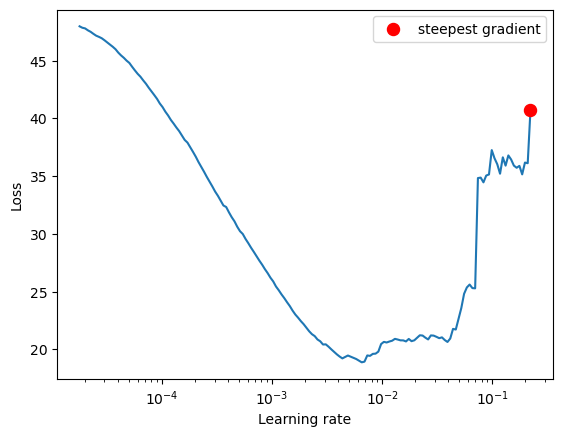

In [4]:
from torch_lr_finder import LRFinder
scaled_anchors = (
    torch.tensor(config.ANCHORS)
    * torch.tensor(config.S).unsqueeze(1).unsqueeze(1).repeat(1, 3, 2)
).to(config.DEVICE)

def criterion(out, y):
    y0, y1, y2 = (
            y[0].to(config.DEVICE),
            y[1].to(config.DEVICE),
            y[2].to(config.DEVICE),
        )
    loss = (
                loss_fn(out[0], y0, scaled_anchors[0])
                + loss_fn(out[1], y1, scaled_anchors[1])
                + loss_fn(out[2], y2, scaled_anchors[2])
            )
    return loss
lr_finder = LRFinder(model, optimizer, criterion, device="cuda")
lr_finder.range_test(train_loader, end_lr=1, num_iter=200, step_mode="exp")
lr_finder.plot() # to inspect the loss-learning rate graph
lr_finder.reset() # to reset the model and optimizer to their initial state

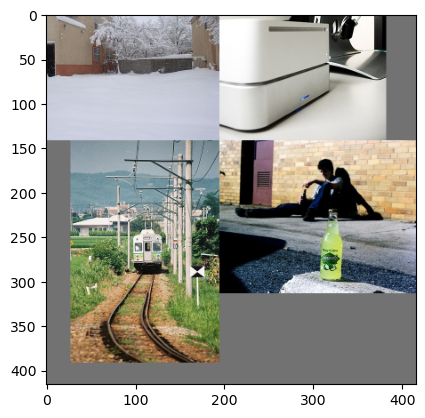

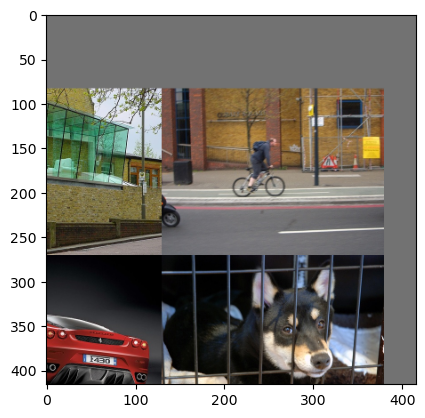

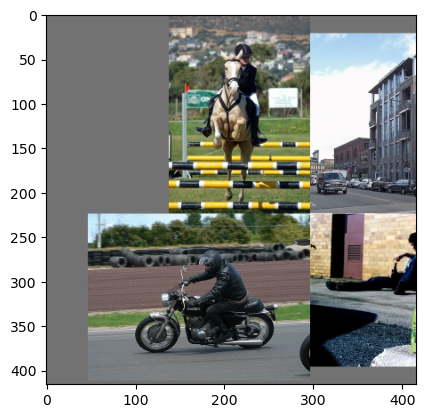

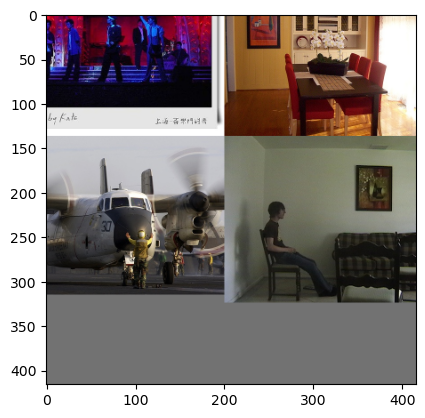

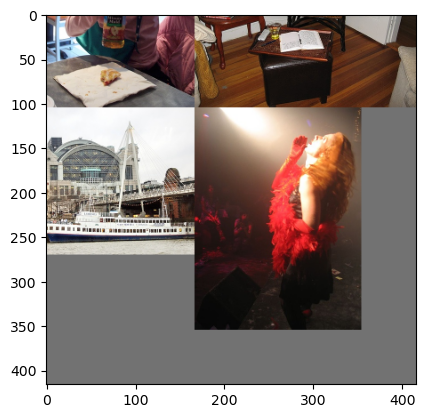

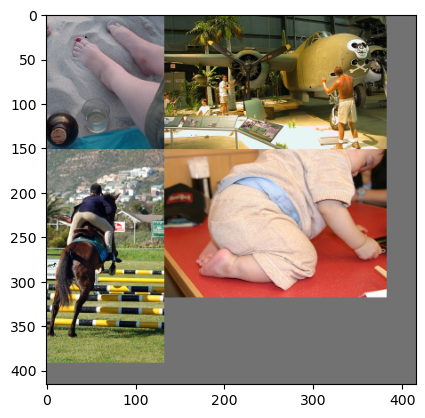

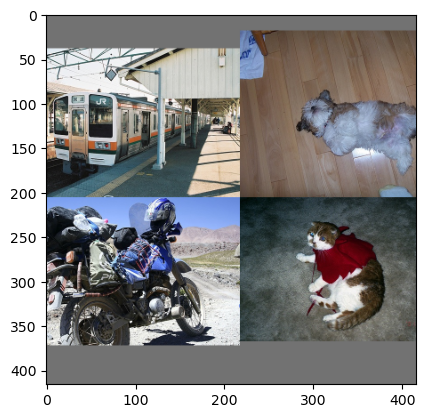

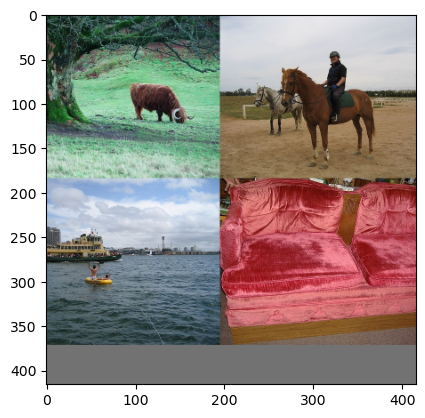

100%|██████████| 518/518 [10:36<00:00,  1.23s/it, loss=11]  


=> Saving checkpoint
Currently epoch 0


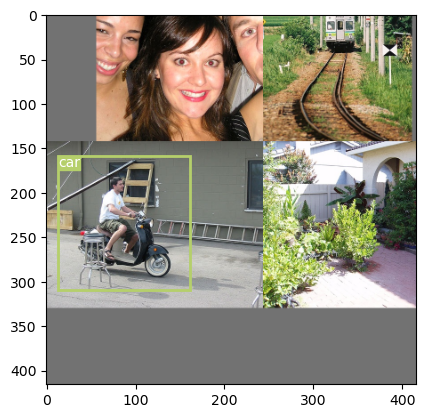

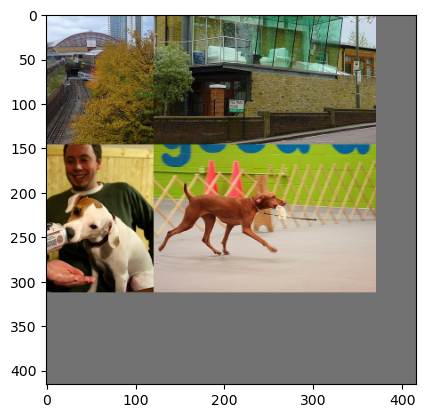

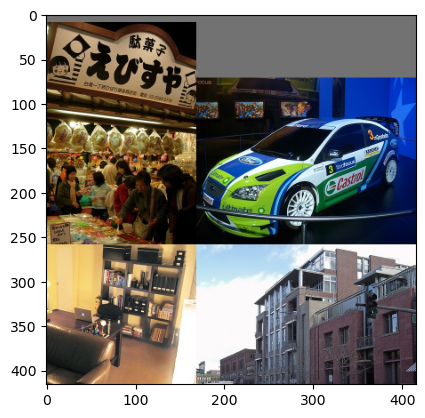

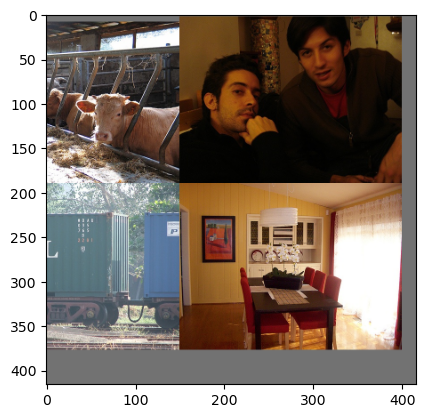

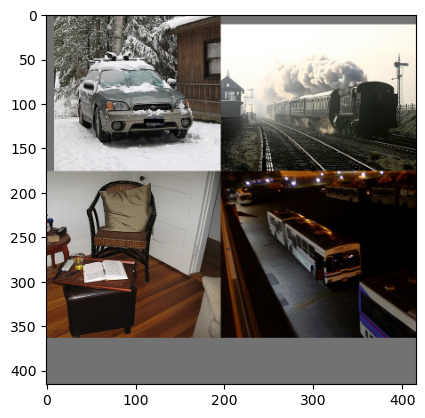

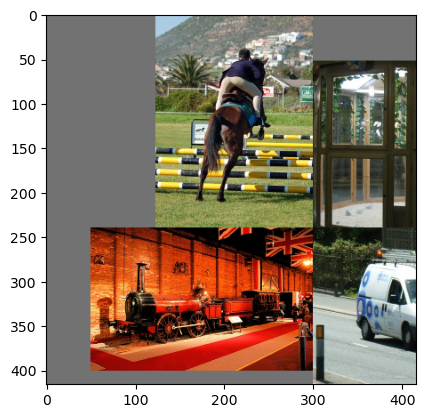

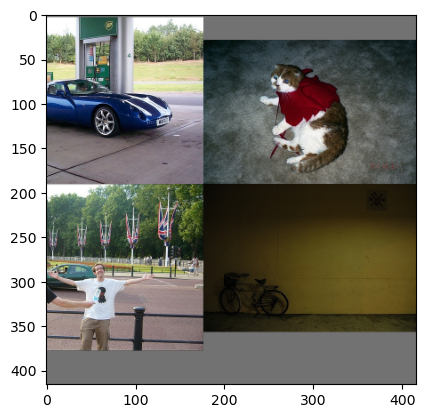

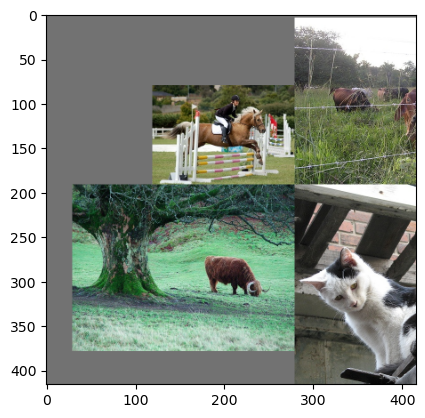

100%|██████████| 518/518 [10:38<00:00,  1.23s/it, loss=10.5]


=> Saving checkpoint
Currently epoch 1


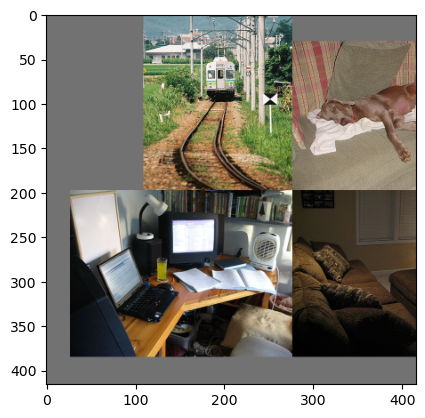

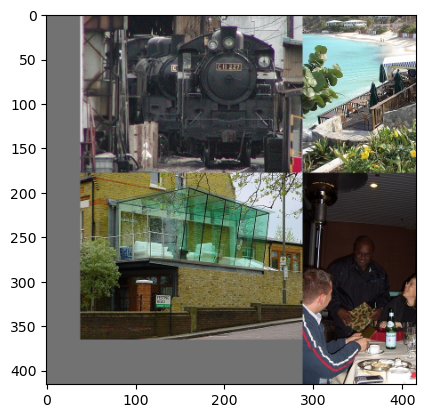

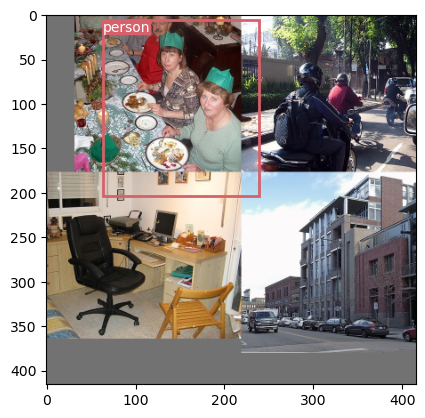

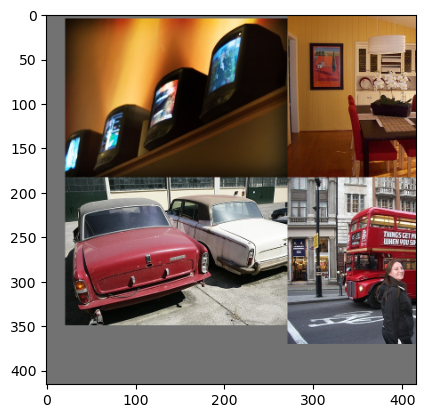

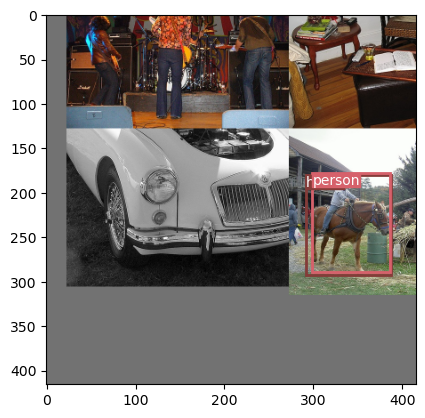

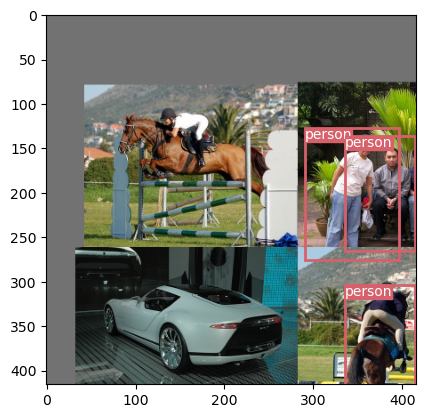

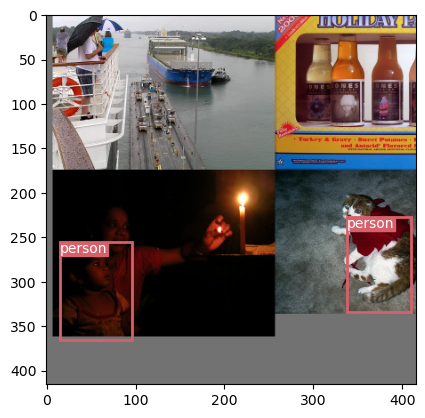

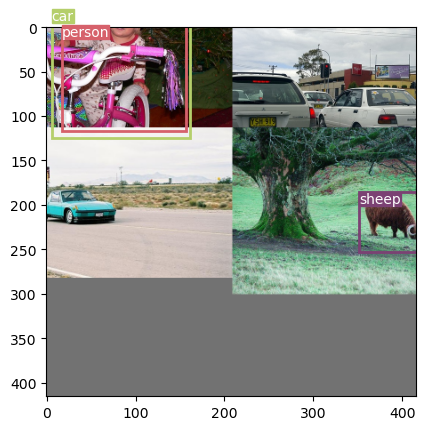

100%|██████████| 518/518 [10:45<00:00,  1.25s/it, loss=9.7] 


=> Saving checkpoint
Currently epoch 2


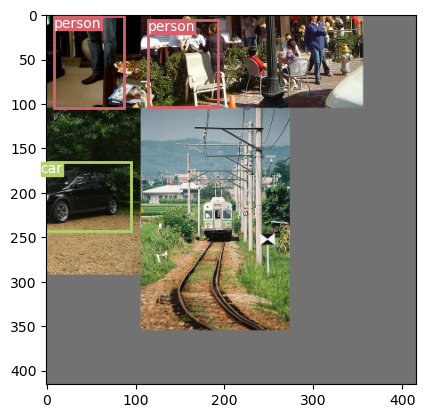

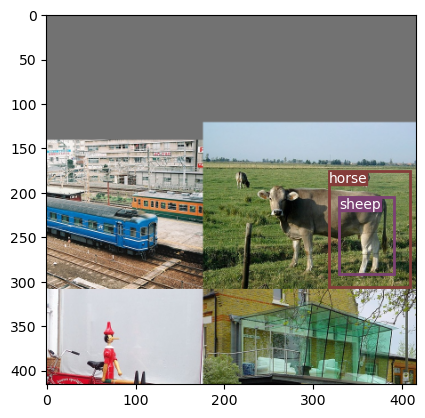

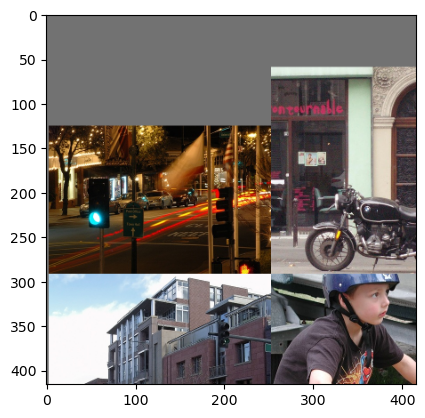

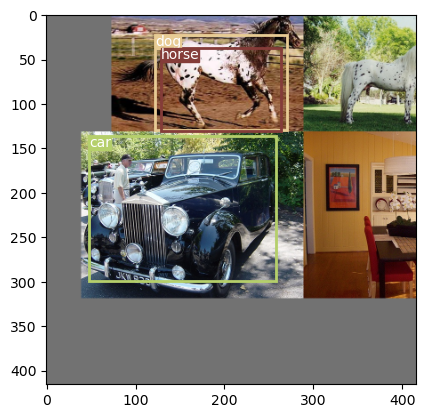

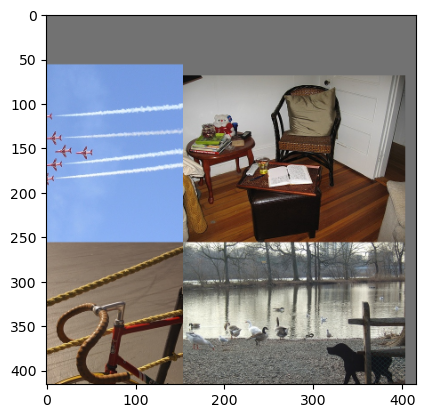

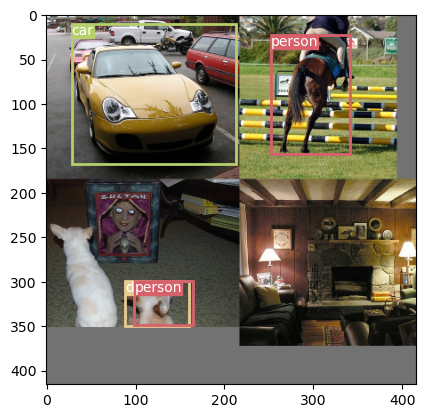

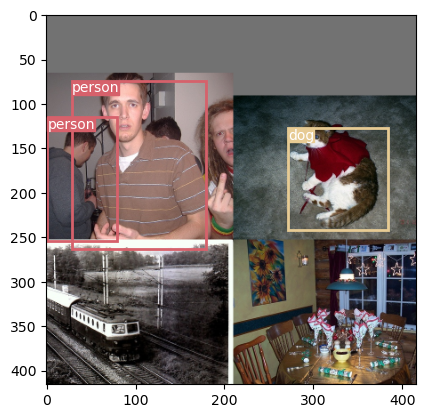

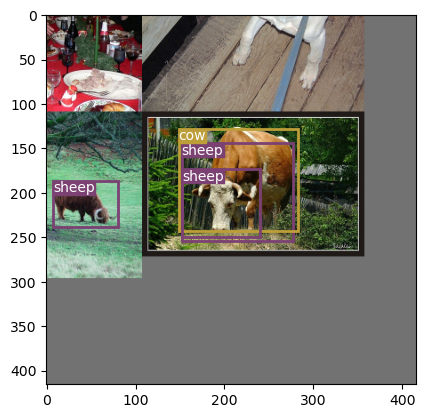

100%|██████████| 518/518 [10:44<00:00,  1.24s/it, loss=9.12]


=> Saving checkpoint
Currently epoch 3


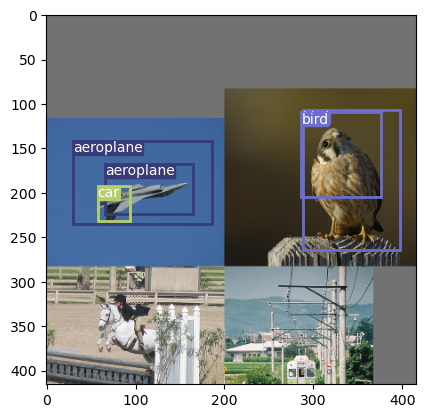

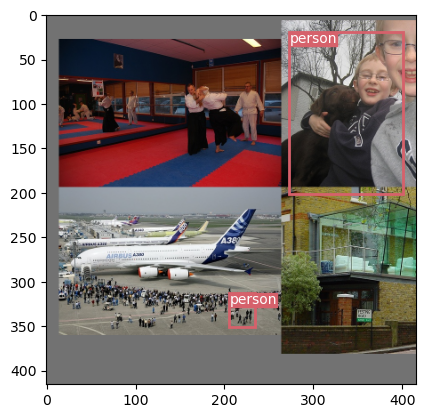

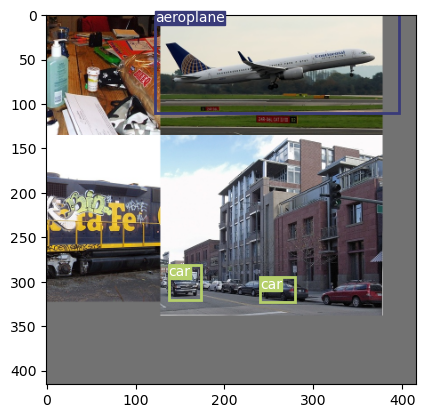

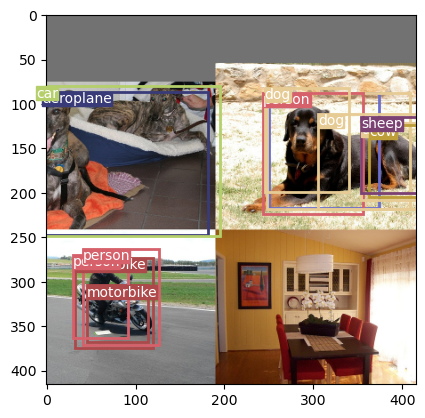

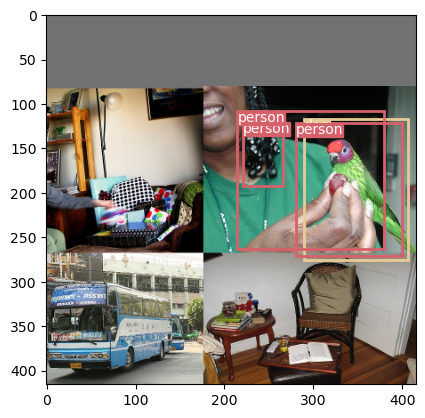

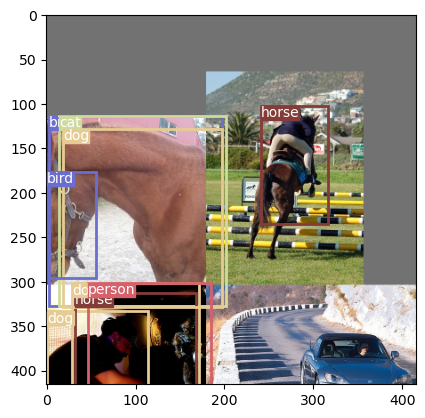

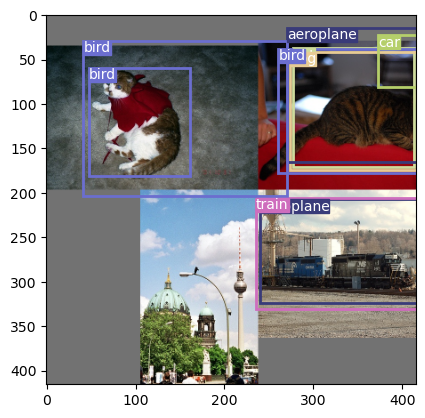

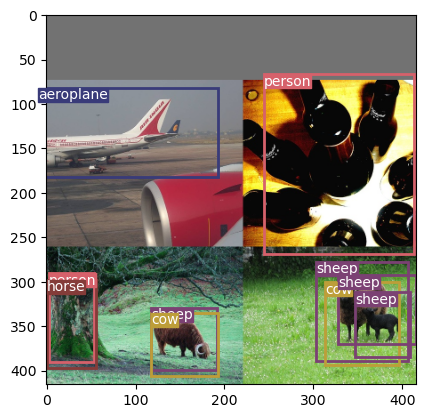

100%|██████████| 518/518 [10:46<00:00,  1.25s/it, loss=8.71]


=> Saving checkpoint
Currently epoch 4


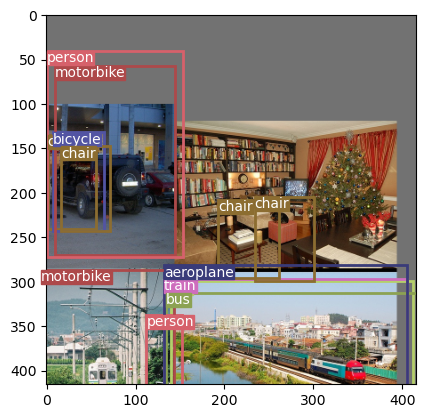

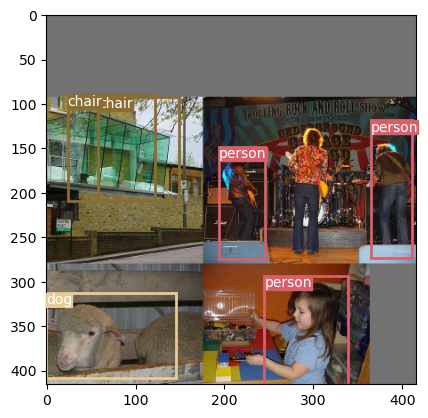

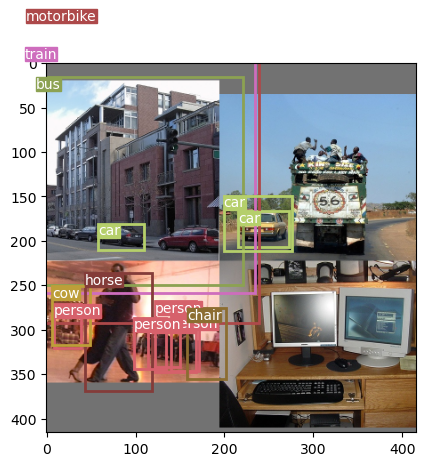

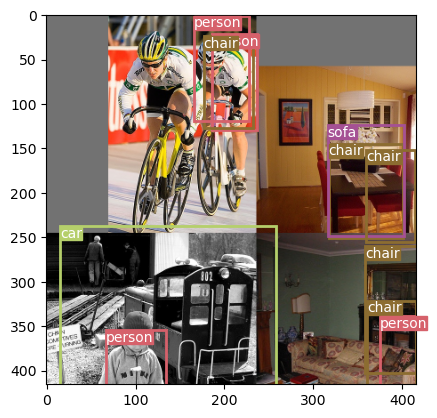

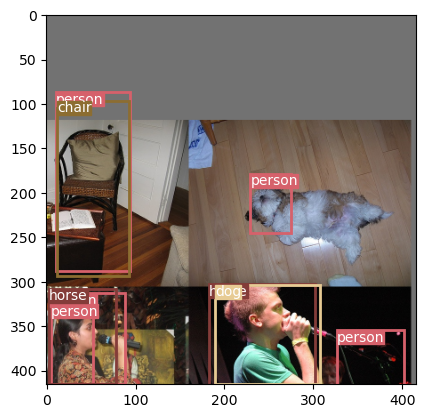

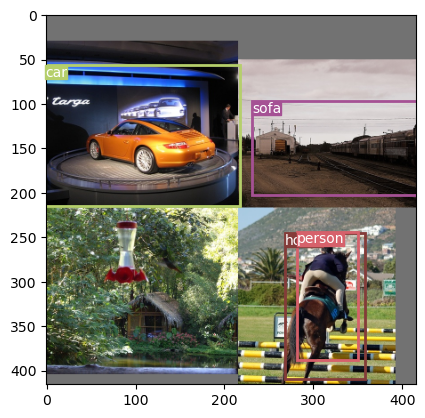

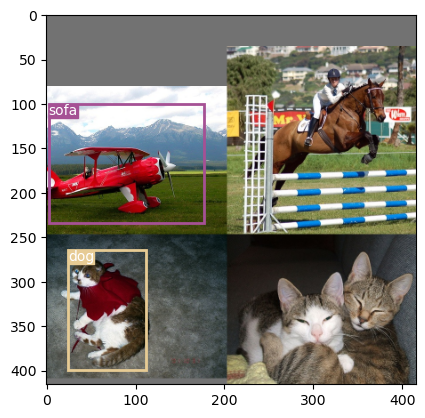

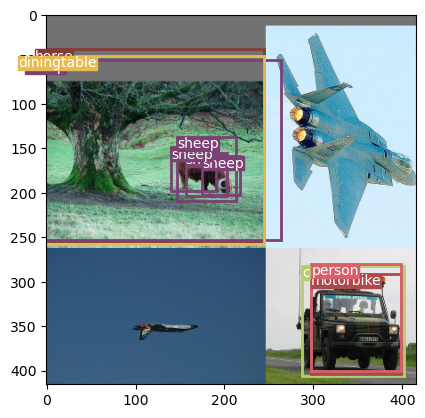

100%|██████████| 518/518 [10:45<00:00,  1.25s/it, loss=8.24]


=> Saving checkpoint
Currently epoch 5


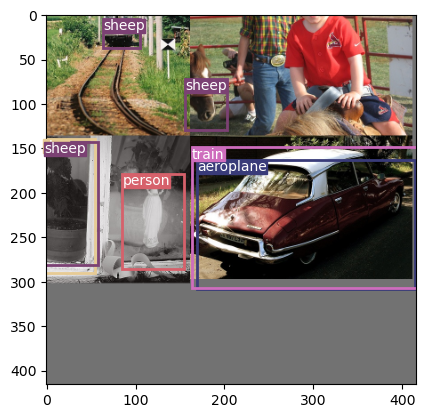

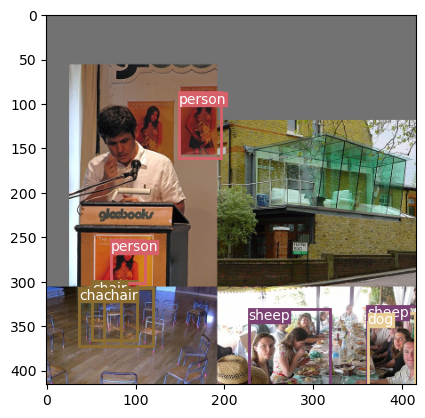

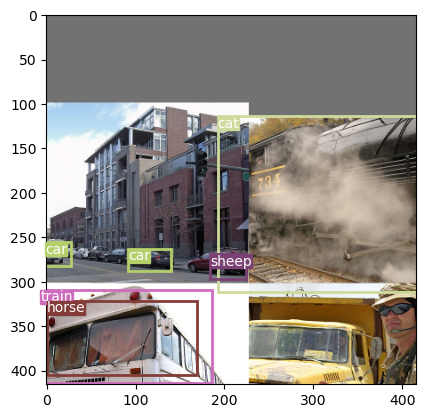

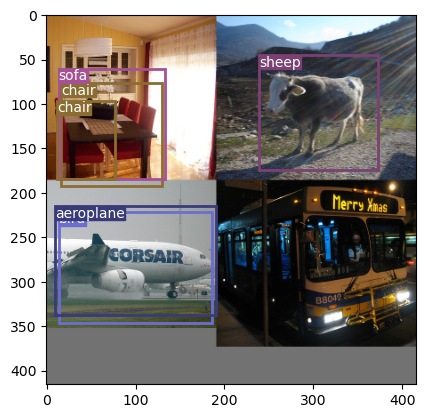

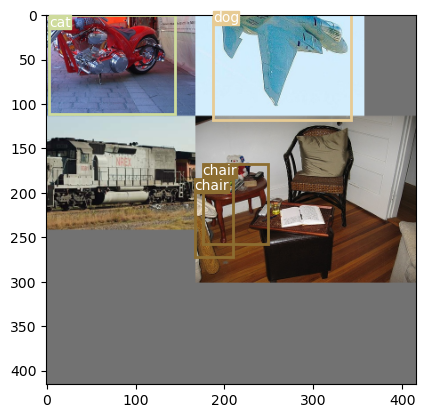

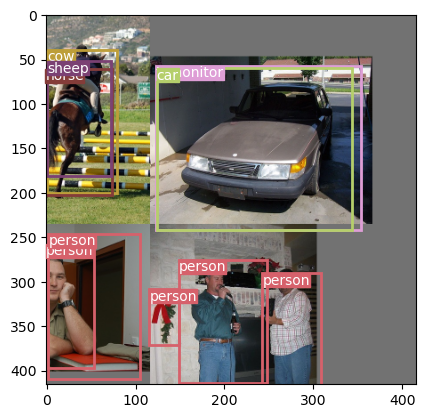

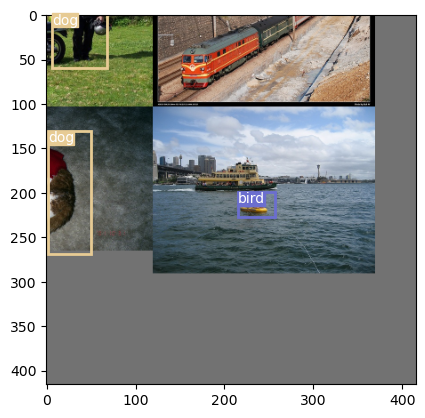

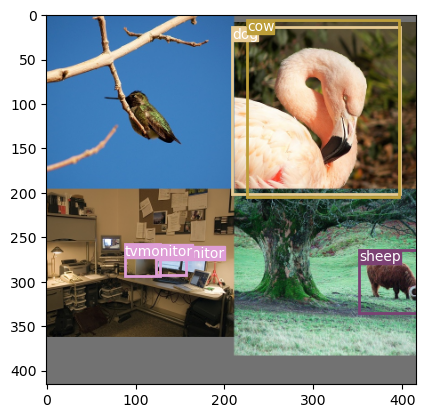

100%|██████████| 518/518 [10:37<00:00,  1.23s/it, loss=7.71]


=> Saving checkpoint
Currently epoch 6
On Train loader:


100%|██████████| 518/518 [10:04<00:00,  1.17s/it]

Class accuracy is: 48.187210%
No obj accuracy is: 97.838089%
Obj accuracy is: 52.161102%


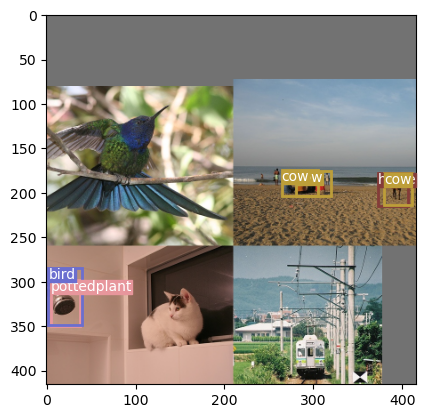

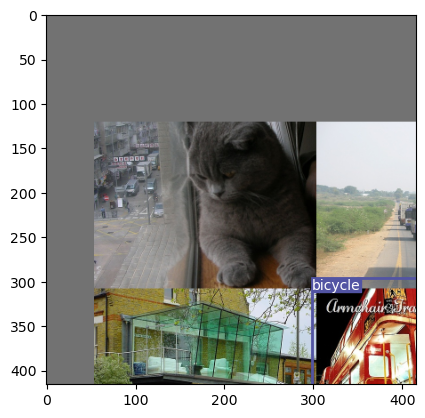

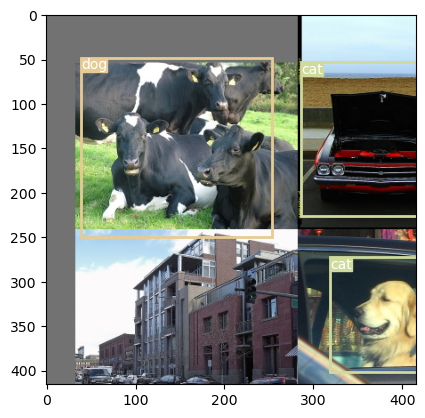

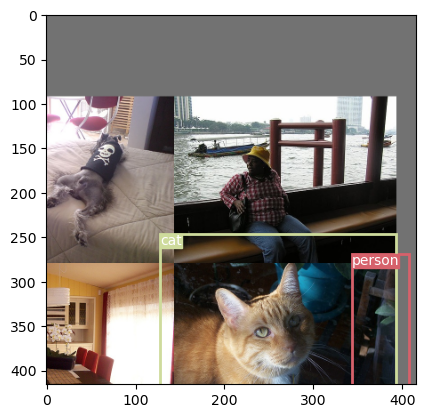

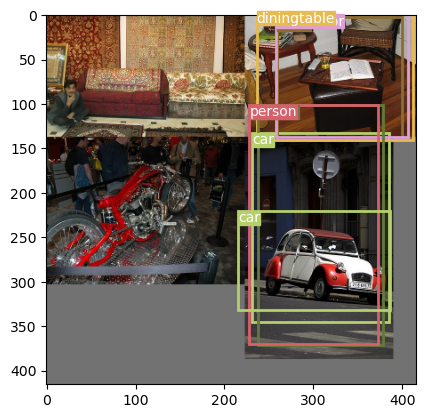

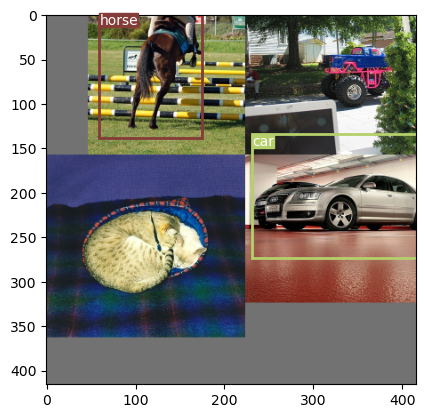

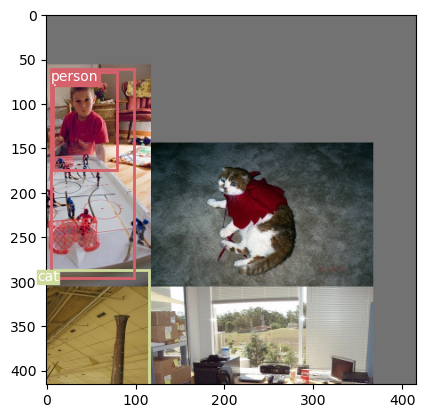

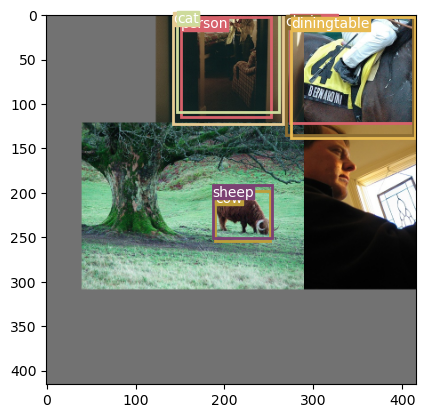

100%|██████████| 518/518 [10:42<00:00,  1.24s/it, loss=7.32]


=> Saving checkpoint
Currently epoch 7


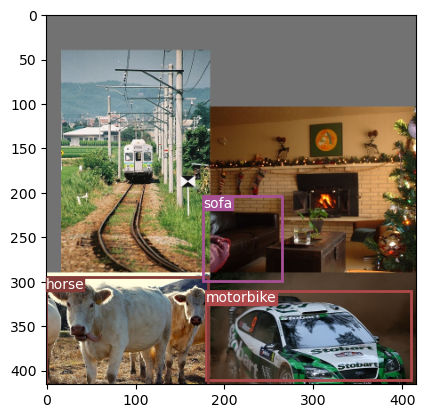

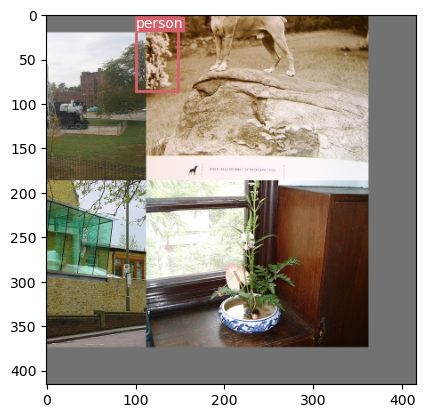

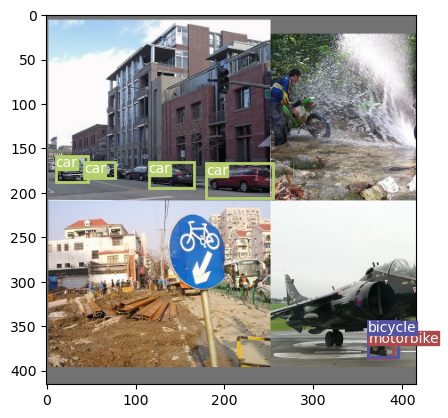

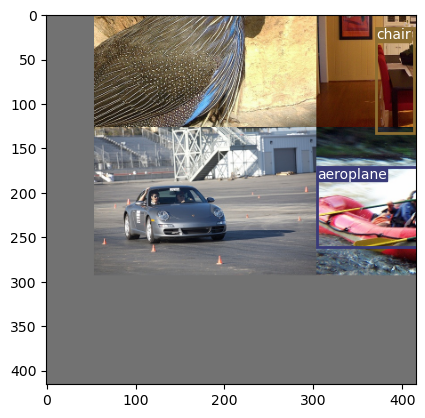

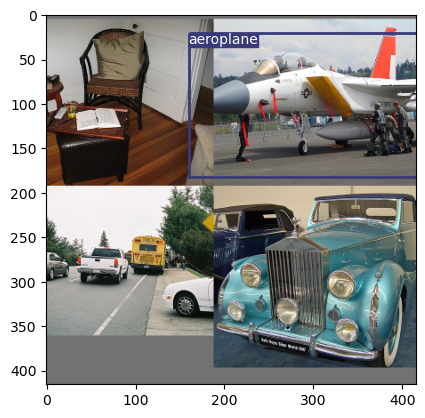

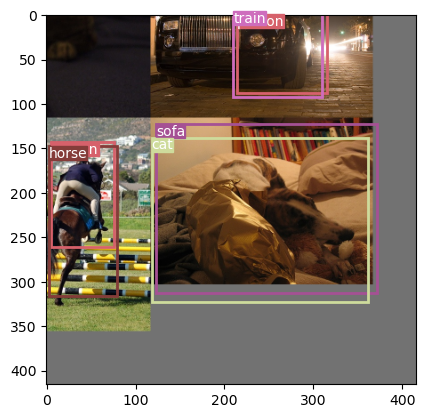

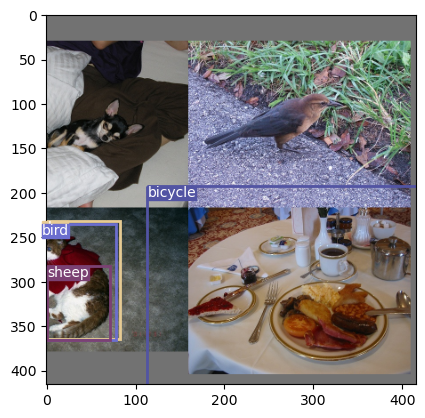

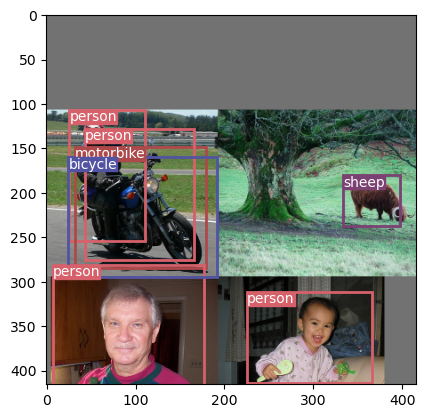

100%|██████████| 518/518 [10:41<00:00,  1.24s/it, loss=7.04]


=> Saving checkpoint
Currently epoch 8


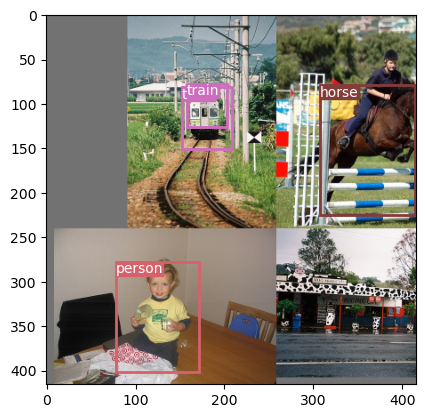

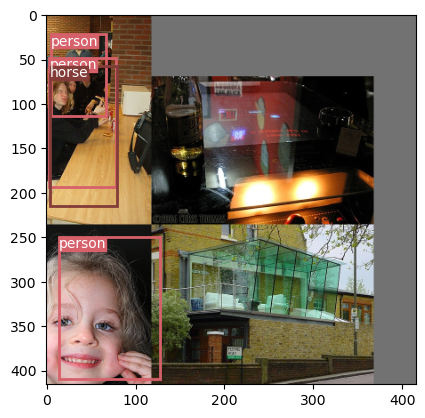

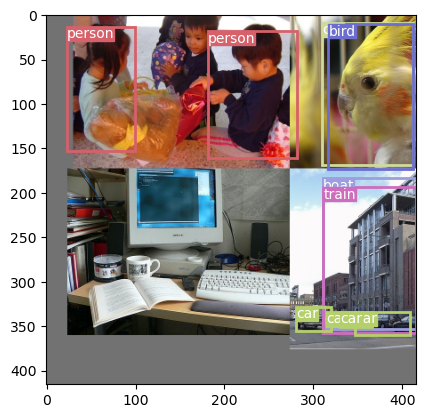

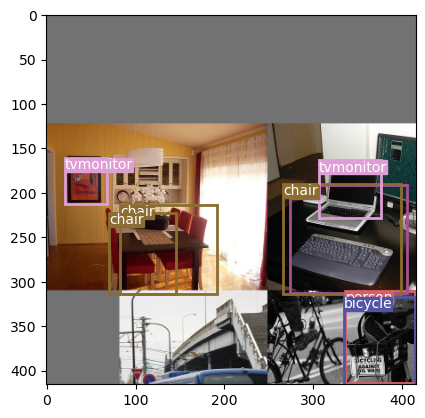

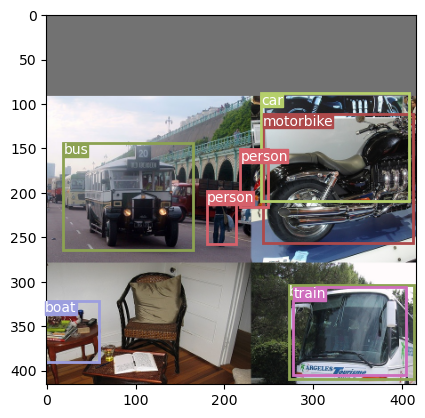

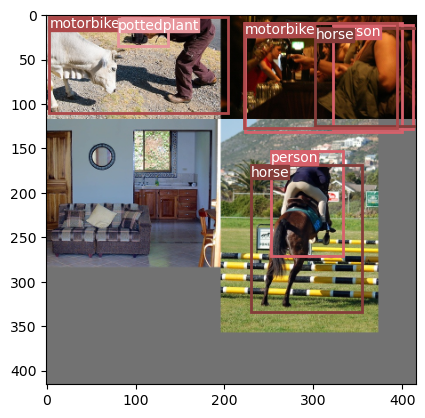

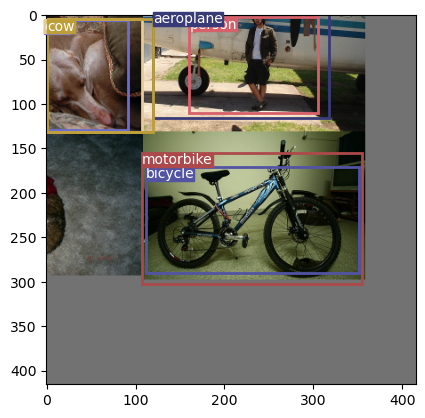

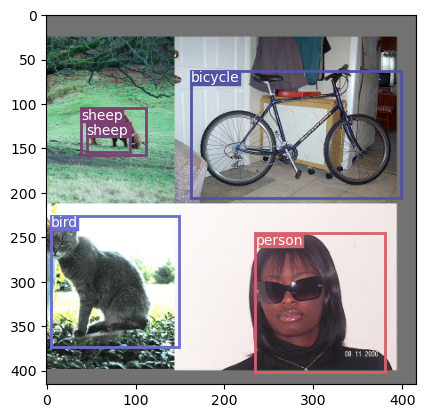

100%|██████████| 518/518 [10:41<00:00,  1.24s/it, loss=6.79]


=> Saving checkpoint
Currently epoch 9


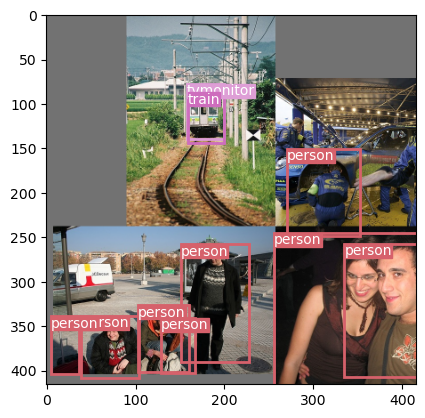

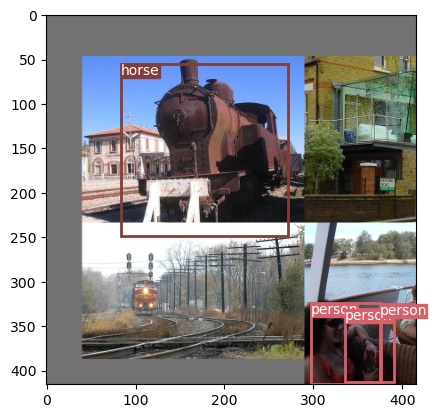

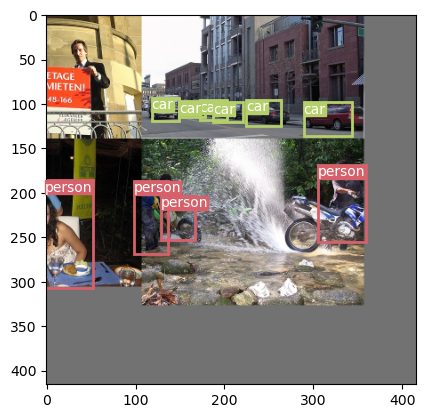

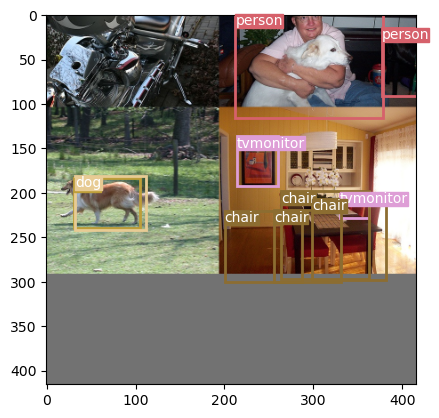

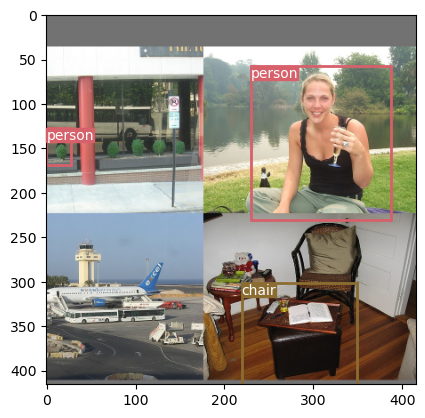

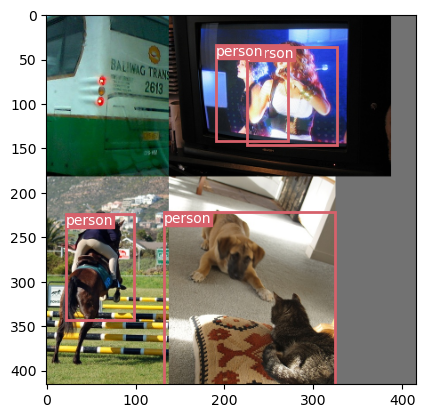

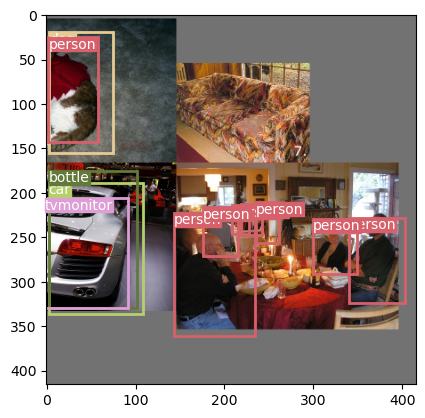

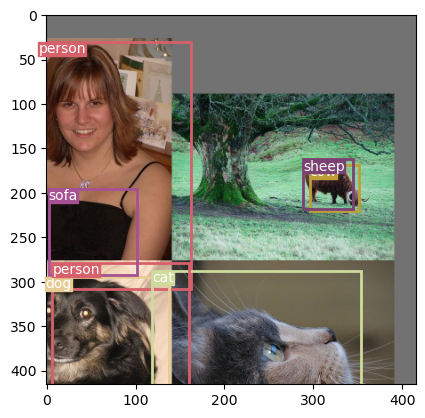

100%|██████████| 518/518 [10:36<00:00,  1.23s/it, loss=6.49]


=> Saving checkpoint
Currently epoch 10


100%|██████████| 155/155 [02:12<00:00,  1.17it/s]


Class accuracy is: 69.727036%
No obj accuracy is: 97.493240%
Obj accuracy is: 62.456154%


100%|██████████| 155/155 [21:10<00:00,  8.20s/it]


MAP: 0.1860000342130661


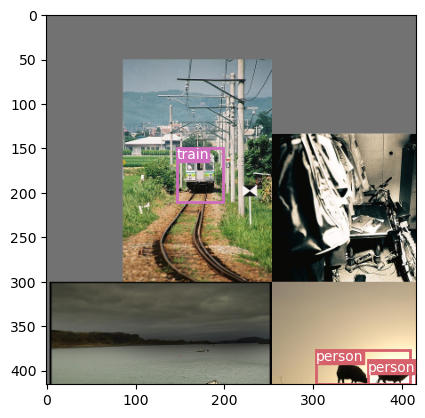

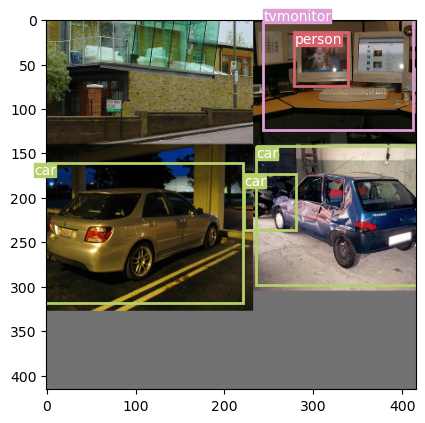

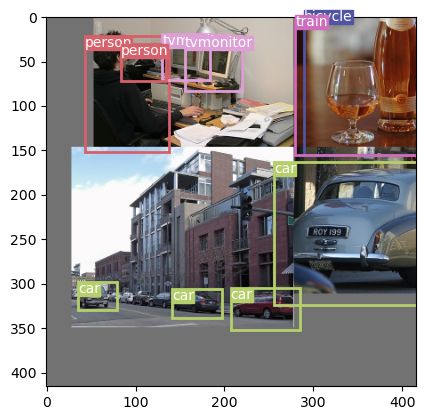

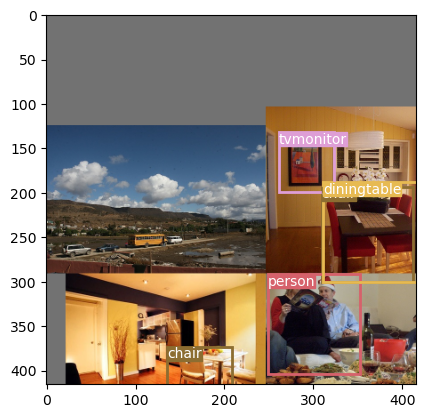

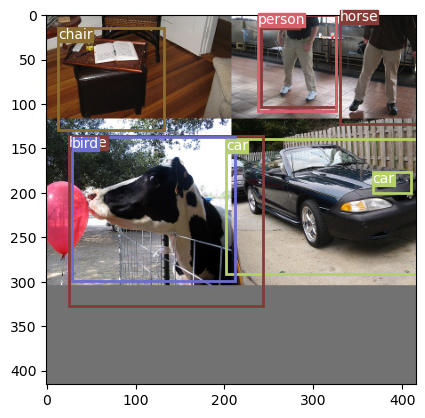

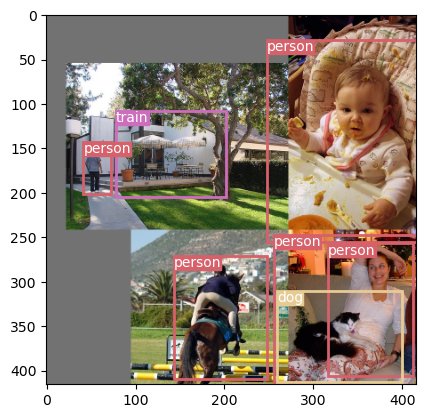

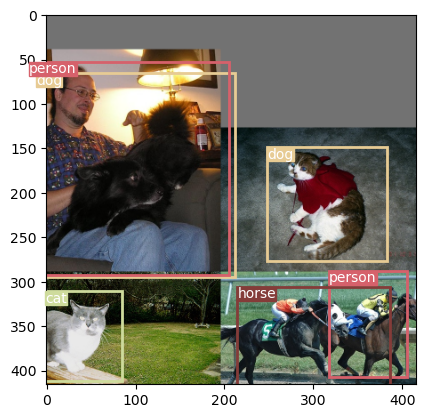

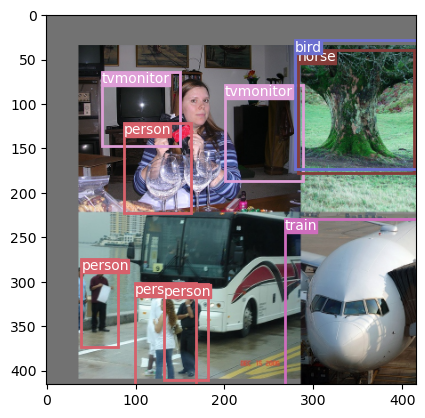

100%|██████████| 518/518 [10:50<00:00,  1.26s/it, loss=6.16]


=> Saving checkpoint
Currently epoch 11


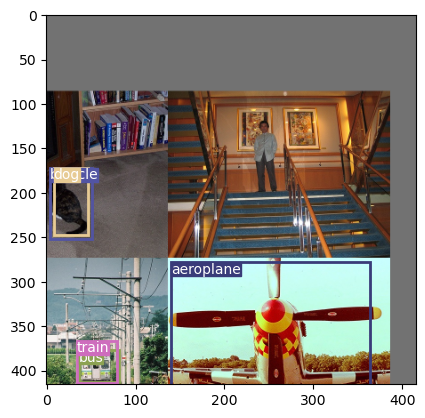

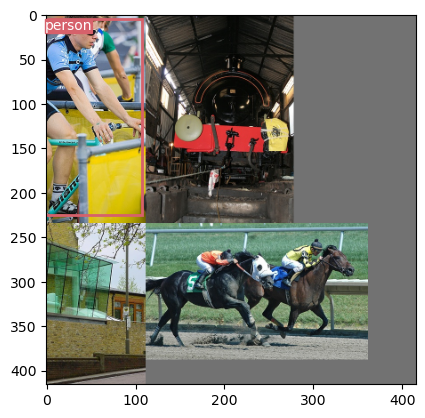

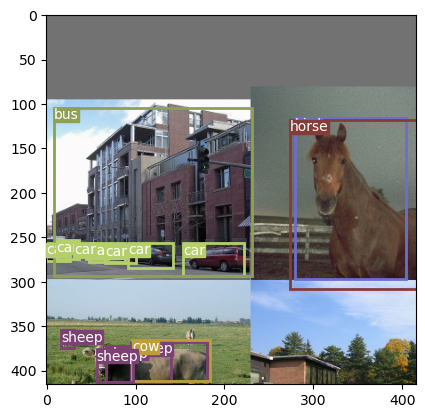

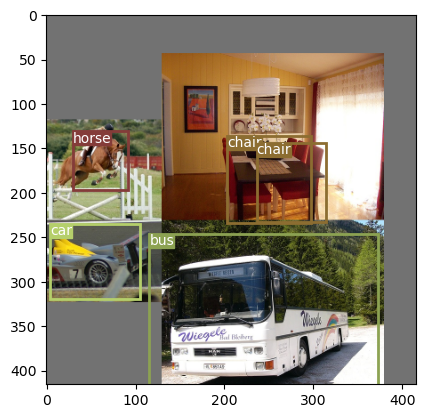

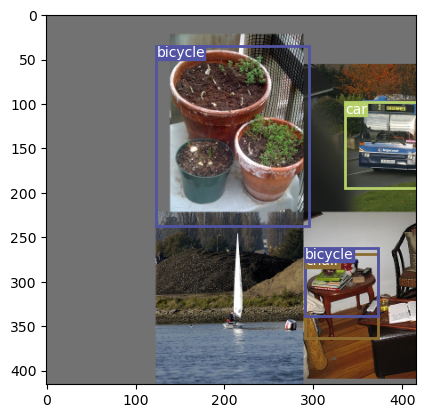

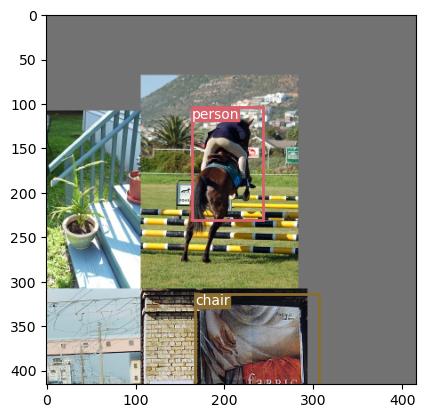

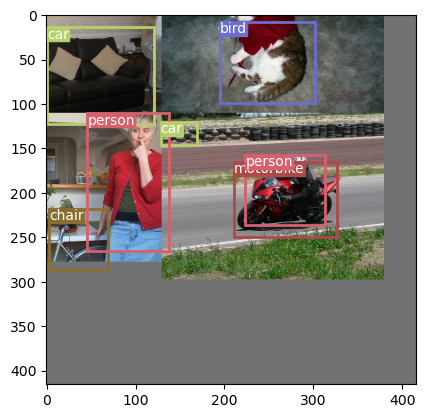

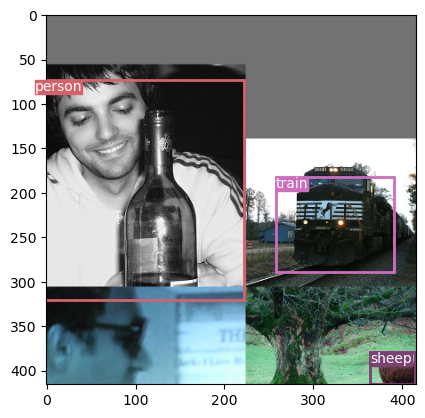

100%|██████████| 518/518 [10:55<00:00,  1.27s/it, loss=5.91]


=> Saving checkpoint
Currently epoch 12
On Train loader:


100%|██████████| 518/518 [10:17<00:00,  1.19s/it]


Class accuracy is: 70.738663%
No obj accuracy is: 97.581306%
Obj accuracy is: 70.312584%


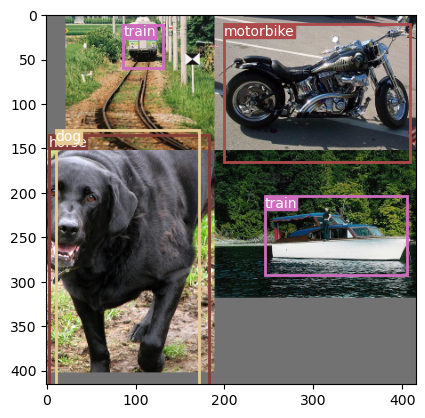

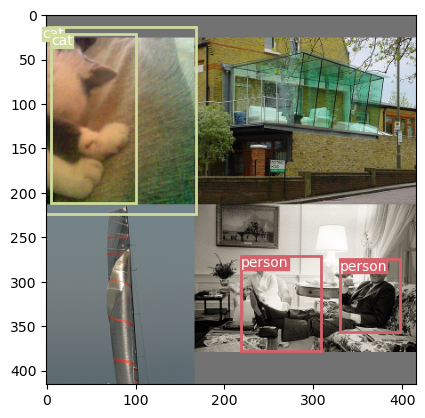

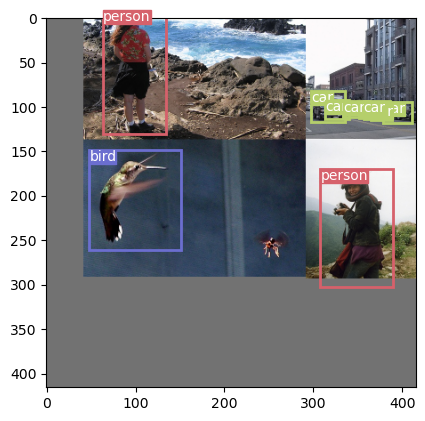

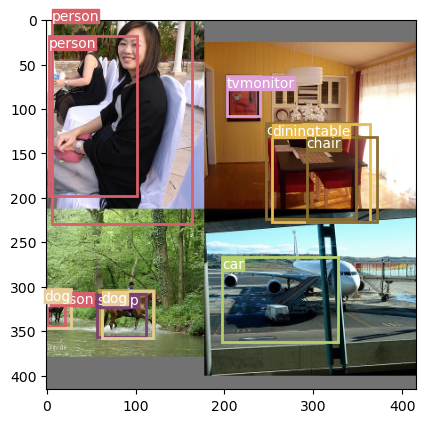

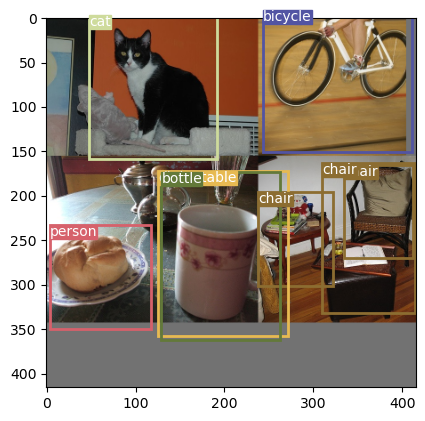

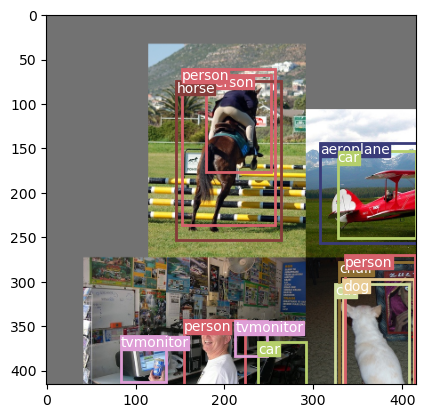

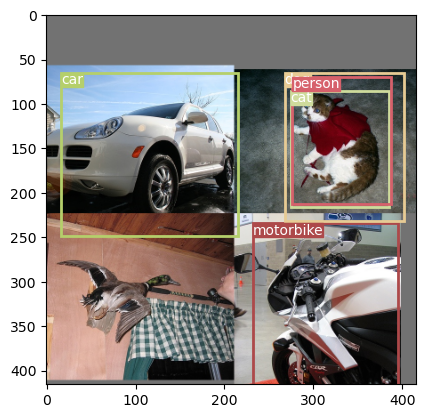

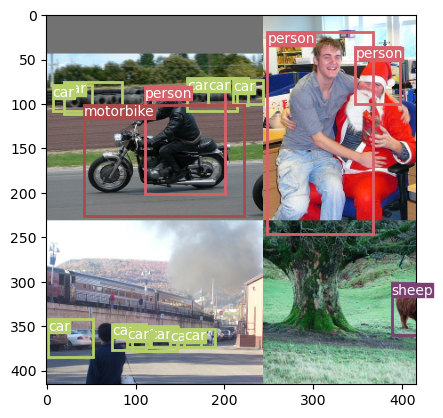

 58%|█████▊    | 303/518 [06:26<04:57,  1.38s/it, loss=5.6] 

In [ ]:
scaled_anchors = (
    torch.tensor(config.ANCHORS)
    * torch.tensor(config.S).unsqueeze(1).unsqueeze(1).repeat(1, 3, 2)
).to(config.DEVICE)


from torch.optim.lr_scheduler import OneCycleLR
EPOCHS = config.NUM_EPOCHS * 2 // 5
scheduler = OneCycleLR(
        optimizer,
        max_lr=1E-3,
        steps_per_epoch=len(train_loader),
        epochs=EPOCHS,
        pct_start=5/EPOCHS,
        div_factor=100,
        three_phase=False,
        final_div_factor=100,
        anneal_strategy='linear'
    )

for epoch in range(EPOCHS):
    plot_couple_examples(model, test_loader, 0.6, 0.5, scaled_anchors)
    train_fn(train_loader, model, optimizer, loss_fn, scaler, scaled_anchors, scheduler)

    if config.SAVE_MODEL:
       save_checkpoint(model, optimizer, filename=f"checkpoint_e3.pth.tar")

    print(f"Currently epoch {epoch}")
    if epoch > 0 and epoch % 6 == 0:
        print("On Train loader:")
        check_class_accuracy(model, train_loader, threshold=config.CONF_THRESHOLD)

    if epoch > 0 and epoch % 10 == 0:
        check_class_accuracy(model, test_loader, threshold=config.CONF_THRESHOLD)
        pred_boxes, true_boxes = get_evaluation_bboxes(
            test_loader,
            model,
            iou_threshold=config.NMS_IOU_THRESH,
            anchors=config.ANCHORS,
            threshold=config.CONF_THRESHOLD,
        )
        mapval = mean_average_precision(
            pred_boxes,
            true_boxes,
            iou_threshold=config.MAP_IOU_THRESH,
            box_format="midpoint",
            num_classes=config.NUM_CLASSES,
        )
        print(f"MAP: {mapval.item()}")
        model.train()